# Idea

- Number of Transfers for that Asset between 1 hour before and after the event (Maybe transfer list if possible)
- Plot transfers  (-> Use plot to answer question wheter or not wallet tracking is suitable / plattforms doing stacked transfers )
- tbd 

- Exemplary perfrom on Raiden Event 
- Extend to X further Events

In [25]:
import pandas as pd
import json
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
from web3_helpers import (
    get_contract_for_symbol,
    get_file_from_alchemy_api,
    get_block_number_for_unix_date,
)
import time
from datetime import datetime, timedelta
import json
import random

In [26]:
lm_df = pd.read_csv("../data/la_morgia_data/pump_telegram.csv")
lm_df.sample(3)

,symbol,group,date,hour,exchange
1064,GRS,CPI,2020-04-02,16:00,binance
621,APPC,TWP,2020-11-04,17:00,binance
1100,BRD,CCS,2020-01-20,16:00,binance


In [27]:
# lm_df = lm_df[lm_df["symbol"] == "RDN"]
# lm_df = lm_df[lm_df["date"] == "2021-08-21"]

# lm_df = lm_df.sample(100, random_state=1)

In [28]:
def download_alchemy_data(lm_df, save_path, categories):
    i = 0

    for index, row in lm_df.iterrows():
        print(" ")

        print(row)

        symbol = row["symbol"]

        contract = get_contract_for_symbol(symbol.lower())

        print(f" Symbol: {symbol}, Contract: {contract}")

        event_time = datetime.strptime(f"{row['date']} {row['hour']}", "%Y-%m-%d %H:%M")

        start_date = event_time - timedelta(hours=12)

        end_date = event_time + timedelta(hours=12)

        print("Datetime timestamps: ", event_time, start_date, end_date)

        unix_start_date = time.mktime(start_date.timetuple())

        unix_end_date = time.mktime(end_date.timetuple())

        print("Unix timestamps: ", unix_start_date, unix_end_date)

        hex_block_number_start = get_block_number_for_unix_date(unix_start_date, True)

        hex_block_number_end = get_block_number_for_unix_date(unix_end_date, True)

        print("Hex Block Numbers: ", hex_block_number_start, hex_block_number_end)

        params = {
            "jsonrpc": "2.0",
            "method": "alchemy_getAssetTransfers",
            "params": [
                {
                    "fromBlock": hex_block_number_start,
                    "toBlock": hex_block_number_end,
                    "contractAddresses": [contract],
                    "category": categories,  # Decide Categories
                    "withMetadata": True,
                    "excludeZeroValue": False,
                    # "maxCount": "0x3e8" # maximum transactions possible
                }
            ],
        }

        i = i + 1

        answer_file = f"{save_path}/{i}_alchemy_answer_{symbol}.json"

        get_file_from_alchemy_api(params, answer_file)

In [29]:
def parse_timestamp(entry):
    if "metadata" in entry and "blockTimestamp" in entry["metadata"]:
        timestamp = entry["metadata"]["blockTimestamp"]
        return datetime.fromisoformat(timestamp.replace("Z", "+00:00"))
    return None


def process_transaction_data_with_year(file_path):
    with open(file_path, "r") as file:
        data = json.load(file)

    filtered_data = [item for item in data if isinstance(item, dict)]

    for i, item in enumerate(filtered_data):
        if not isinstance(item, dict):
            print(f"Non-dict item at index {i}: {item}")
    df = pd.DataFrame(filtered_data)
    print("HERE HERE HERE DONE DONE DONE")

    df["timestamp"] = df.apply(lambda entry: parse_timestamp(entry), axis=1)
    df.dropna(subset=["timestamp"], inplace=True)
    df["timestamp"] = pd.to_datetime(df["timestamp"])
    year = df["timestamp"].dt.year.mode()[0] if not df["timestamp"].empty else None
    df["hour"] = df["timestamp"].dt.hour
    hourly_transactions = df.groupby("hour").size()
    return hourly_transactions, year


def plot_hourly_transactions_with_year_and_mean(file_paths):
    plt.figure(figsize=(12, 6))
    all_hourly_transactions = []

    for file_path in file_paths:
        print("File Path: ", file_path)

        hourly_transactions, year = process_transaction_data_with_year(file_path)
        hourly_transactions = hourly_transactions.reindex(range(24), fill_value=0)
        color = (
            "green"
            if year == 2019
            else "blue"
            if year == 2020
            else "yellow"
            if year == 2021
            else "black"
        )
        plt.plot(
            hourly_transactions,
            label=f"Transactions in {file_path} ({year})",
            color=color,
            alpha=0.4,
        )
        all_hourly_transactions.append(hourly_transactions)

    if all_hourly_transactions:
        mean_transactions = pd.concat(all_hourly_transactions, axis=1).mean(axis=1)
        plt.plot(
            mean_transactions,
            label="Mean Transactions",
            color="red",
            linestyle="--",
            marker="*",
        )

        med_transactions = pd.concat(all_hourly_transactions, axis=1).median(axis=1)
        plt.plot(
            med_transactions,
            label="Median Transactions",
            color="orange",
            linestyle="--",
            marker="*",
        )

    x_labels = [
        f"+{i-12}" if i > 12 else "Event Time" if i == 12 else f"{i-12}"
        for i in range(24)
    ]
    plt.xticks(range(24), x_labels, rotation=45)

    plt.ylim(0, 50)
    plt.xlabel("Hour")
    plt.ylabel("Number of Transactions")
    plt.title("Hourly Transactions by Year with Mean")
    # plt.legend()
    plt.grid(True)
    plt.show()

In [30]:
# plot_hourly_transactions_with_year_and_mean(files)

#files.remove("./alchemy_answers/alchemy_answer_BNT.json")
#files.remove("./alchemy_answers/alchemy_answer_POWR.json")
#files.remove("./alchemy_answers/alchemy_answer_SNT.json")
#files.remove("./alchemy_answers/alchemy_answer_STORJ.json")
#files.remove("./alchemy_answers/alchemy_answer_STPT.json")
#files.remove("./alchemy_answers/alchemy_answer_WPR.json")

plot_hourly_transactions_with_year_and_mean(files)

In [67]:
import json
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime


def parse_timestamp(entry):
    try:
        if "metadata" in entry and "blockTimestamp" in entry["metadata"]:
            timestamp = entry["metadata"]["blockTimestamp"]
            return datetime.fromisoformat(timestamp.replace("Z", "+00:00"))
    except Exception as e:
        return None
    return None


def process_transaction_data(file_path):
    with open(file_path, "r") as file:
        data = json.load(file)
    filtered_data = [item for item in data if isinstance(item, dict)]
    df = pd.DataFrame(filtered_data)
    df["timestamp"] = df.apply(lambda entry: parse_timestamp(entry), axis=1)
    df = df.dropna(subset=["timestamp"])
    df["timestamp"] = pd.to_datetime(df["timestamp"])
    df["year"] = df["timestamp"].dt.year
    df["hour"] = df["timestamp"].dt.hour
    # Filter out data from the year 2021
    df = df[df["year"] != 2021]
    return df.groupby(["year", "hour"]).size().reset_index(name="transaction_count")


def combine_yearly_data(file_paths):
    all_data = pd.DataFrame()
    for file_path in file_paths:
        df = process_transaction_data(file_path)
        all_data = pd.concat([all_data, df], ignore_index=True)
    return all_data


def plot_hourly_quartile_areas_with_mean_median(file_paths):
    combined_data = combine_yearly_data(file_paths)

    plt.rcParams["font.size"] = 14
    plt.rcParams["axes.titlesize"] = 16
    plt.rcParams["axes.labelsize"] = 14
    plt.rcParams["xtick.labelsize"] = 11
    plt.rcParams["ytick.labelsize"] = 11
    plt.figure(figsize=(10, 5.5))

    # Plot quartile areas for each year
    for year in combined_data["year"].unique():
        year_data = combined_data[combined_data["year"] == year]
        quartiles = (
            year_data.groupby("hour")["transaction_count"]
            .quantile([0.25, 0.75])
            .unstack(level=-1)
        )
        plt.fill_between(
            quartiles.index,
            quartiles[0.25],
            quartiles[0.75],
            alpha=0.5,
            label=f"{year} Quartile Range",
        )

    # Calculate and plot overall mean and median
    overall_mean = combined_data.groupby("hour")["transaction_count"].mean()
    overall_median = combined_data.groupby("hour")["transaction_count"].median()

    plt.plot(
        overall_mean.index,
        overall_mean.values,
        color="green",
        label="Overall Mean",
        linestyle="-",
        marker="o",
    )
    plt.plot(
        overall_median.index,
        overall_median.values,
        color="purple",
        label="Overall Median",
        linestyle="-",
        marker="x",
    )

    x_labels = [
        f"+{i-12}" if i > 12 else "Event Time" if i == 12 else f"{i-12}"
        for i in range(24)
    ]
    plt.xticks(range(24), x_labels, rotation=60)

    event_time_index = x_labels.index("Event Time")
    plt.axvline(
        x=event_time_index, color="black", linestyle="--", linewidth=1.5, alpha=0.7
    )

    plt.xlabel("Hour")
    plt.ylabel("Transaction Count")
    plt.title("Hourly Transaction Analysis")
    plt.legend(loc="upper left")
    plt.grid(True)
    plt.tight_layout()
    plt.savefig("./transfers_overall.png")
    plt.show()

 
symbol             BRD
group              ATW
date        2018-12-22
hour             17:00
exchange       binance
Name: 125, dtype: object
HERE
{'binance-smart-chain': '0x4950c48ccf576d185eb3a0820728a6cfe435d493'}
No contract for ethereum specified
{'algorand': '1054801592'}
No contract for ethereum specified
 Symbol: BRD, Contract: 0x558ec3152e2eb2174905cd19aea4e34a23de9ad6
Datetime timestamps:  2018-12-22 17:00:00 2018-12-22 05:00:00 2018-12-23 05:00:00
Unix timestamps:  1545451200.0 1545537600.0


Hex Block Numbers:  0x69c000 0x69d6bd
{'jsonrpc': '2.0', 'id': None, 'result': {'transfers': [{'blockNum': '0x69c050', 'uniqueId': '0x82929410c3f7250c7dcc9b9db9613ce3d6c03947bbbe52487d66b228b672f9c2:log:68', 'hash': '0x82929410c3f7250c7dcc9b9db9613ce3d6c03947bbbe52487d66b228b672f9c2', 'from': '0xf8586bb82f330f7851f3145b6baa930138d8e9be', 'to': '0xc731c5190287de7be026794665494febb714371f', 'value': 30, 'erc721TokenId': None, 'erc1155Metadata': None, 'tokenId': None, 'asset': 'BRD', 'category': 'erc20', 'rawContract': {'value': '0x01a055690d9db80000', 'address': '0x558ec3152e2eb2174905cd19aea4e34a23de9ad6', 'decimal': '0x12'}, 'metadata': {'blockTimestamp': '2018-12-22T04:22:10.000Z'}}, {'blockNum': '0x69c07f', 'uniqueId': '0x64cd15ad4b6844cba2858b8641094da156951344b74e4424f4c408c5f812e1c1:log:43', 'hash': '0x64cd15ad4b6844cba2858b8641094da156951344b74e4424f4c408c5f812e1c1', 'from': '0x9520d4f751907a93da69322c25741bb492b9a95e', 'to': '0xc731c5190287de7be026794665494febb714371f', 'value':

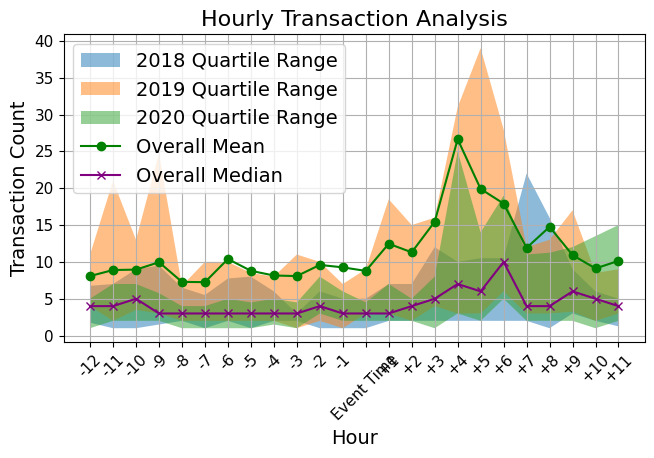

In [32]:
# Binance
lm_df = pd.read_csv("../data/la_morgia_data/pump_telegram.csv")

save_path = "./alchemy_answers/binance_erc20"
categories = ["erc20"]
lm_df = lm_df[lm_df["exchange"] == "binance"]
download_alchemy_data(lm_df, save_path, categories)

files = os.listdir(save_path)
files = [f"{save_path}/{x}" for x in files]

file_paths = files
plot_hourly_quartile_areas_with_mean_median(file_paths)

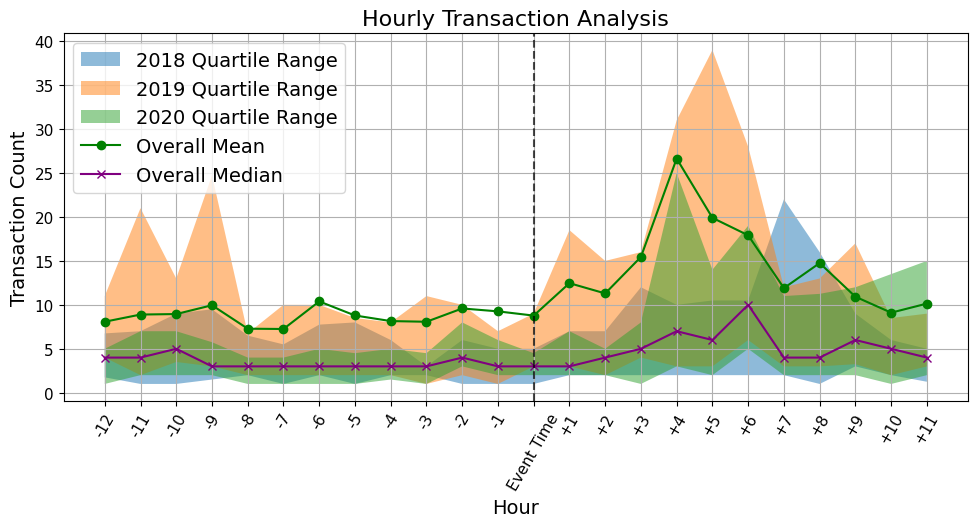

In [68]:
plot_hourly_quartile_areas_with_mean_median(file_paths)